# ERA5-Land Monthly Aggregates and Degree Days for Douglas-fir Plots

This notebook pulls ERA5-Land **hourly** weather data from Google Earth Engine (GEE) and converts it into **monthly summaries** at a set of Douglas-fir plot locations.

For each month and site, we compute:

* Maximum, minimum, and mean 2 m air temperature (°C)
* Total monthly precipitation (m)
* Monthly sums of **degree days** above one or more base temperatures (°C), using 4-hour intervals as the time step
* Zonal statistics (point-based) extracted at the coordinates of tree-ring plots
* A final CSV of site × month × weather metrics exported to Google Drive

The workflow is:

1. Authenticate and initialize Earth Engine.
2. Define helper functions to add date properties and compute degree days.
3. Aggregate ERA5 hourly data into **monthly** temperature and precipitation products.
4. Generate monthly degree-day sums for multiple base temperatures.
5. Load plot locations from a CSV and convert them to a GEE `FeatureCollection`.
6. Compute zonal statistics (per site, per month) using a generic `zonal_stats` helper.
7. Export the resulting table to Google Drive as a CSV, optionally looping over multi-year chunks.


## 1. Setup and Earth Engine Initialization
* `PROJECT` is the Earth Engine project name.
* `ee.Authenticate()` and `ee.Initialize()` set up access to GEE.
* After this, the notebook can request ERA5-Land data and run server-side computations.


In [ ]:
import datetime
import ee
import math

PROJECT = "douglas-fir-tree-ring-data"
ee.Authenticate()
ee.Initialize(project=PROJECT)
# After this, the notebook can request ERA5-Land data and run server-side computations.

## 2. Add Date Properties to Each Image
* Takes an ERA5 hourly `Image`.
* Extracts the timestamp from `system:time_start`.
* Adds:
  * `day_of_year`: integer day index within the year
  * `hour`: hour of day (0–23)
* These properties let us group and aggregate images by day and by 4-hour intervals later on.

In [ ]:
def add_date_properties(image):
    """Add day of year and hour properties to an image."""
    date = ee.Date(image.get('system:time_start'))
    hour = date.get('hour')
    day_of_year = date.getRelative('day', 'year')
    return image.set('day_of_year', day_of_year).set('hour', hour)

## 3. Compute 4-Hourly Degree Days Above a Base Temperature
* Selects the ERA5 `temperature_2m` band (in Kelvin) and converts it to °C.
* Computes **degree days above `base_temp`**:
$$
\text{deg\_days} = \max\left( T_{\text{Celsius}} - T_{\text{base}},\ 0 \right)
$$
* Negative values are clipped to 0 using `.max(0)`.
* Returns a single-band image renamed `degree_days_above_{base_temp}`.
* The assumption is that each input image represents a 4-hour interval, so the degree value is per 4-hour step.


In [ ]:
def compute_4hourly_degree_days(image, base_temp=-20):
    """Compute degree days above a base temperature for a 4-hourly image."""
    temp_band = image.select('temperature_2m').subtract(273.15)  # Convert Kelvin to Celsius
    degree_days = temp_band.subtract(base_temp).max(0)
    return degree_days.rename(f'degree_days_above_{base_temp}')

## 4. Aggregate 4-Hourly Degree Days to Monthly Sums
* Takes a `(year, month)` and a `base_temp`.
* Pulls **ERA5-Land hourly** images for that month.
* For each image:
  * Computes degree days above `base_temp`.
  * Attaches `day_of_year` and `hour` with `add_date_properties`.
* Uses `reduce(ee.Reducer.sum())` and `reduce(ee.Reducer.count())` to:
  * Compute total degree-day values per day (`daily_sum`).
  * Compute how many 4-hour intervals contributed per day (`daily_count`).
* Computes **daily averages**: `daily_avg = daily_sum / daily_count`, which helps deal with any missing intervals.
* Sums daily averages over the month -> `monthly_sum_degree_days_above_{base_temp}`.
* Adds `year` and `month` as bands for easier identification downstream.

Result: a single `Image` representing **monthly degree-day sum** for that base temp (plus bookkeeping bands).


In [ ]:
def aggregate_monthly_degree_days(monthly_date, base_temp):
    """Aggregate degree days above a base temperature for a given month."""
    year, month = monthly_date  # unpacking a tuple
    start_date = ee.Date.fromYMD(year, month, 1)
    end_date = start_date.advance(1, 'month')

    era_hourly = ee.ImageCollection("ECMWF/ERA5_LAND/HOURLY").filterDate(start_date, end_date)

    # compute 4-hourly degree days + add date properties
    degree_days = era_hourly.map(lambda img: compute_4hourly_degree_days(img, base_temp)).map(add_date_properties)

    # sum degree days by day
    daily_sum = degree_days.reduce(ee.Reducer.sum())
    # count the number of 4-hour intervals per day
    daily_count = degree_days.reduce(ee.Reducer.count())
    # calculate the average degree days per day to account for missing data
    daily_avg = daily_sum.divide(daily_count).rename(f'daily_avg_degree_days_above_{base_temp}')

    # sum the daily averages over the month
    monthly_sum = daily_avg.reduce(ee.Reducer.sum()).rename(f'monthly_sum_degree_days_above_{base_temp}')

    # add year and month as bands
    year_band = ee.Image.constant(year).rename('year').toFloat()
    month_band = ee.Image.constant(month).rename('month').toFloat()

    # Combine results
    combined = monthly_sum.addBands(year_band).addBands(month_band)

    return combined

## 5. Aggregate Monthly Temperature and Precipitation
* General utility for any ERA5 band.
* Supported operations: `max`, `min`, `mean`, `sum`.
* For temperature bands (band name contains `'temperature'`), it converts Kelvin to °C.
* Sets `system:time_start` to the first day of the month, so the image is time-stamped by its month.

Used elsewhere to compute:

* `max_temp` (monthly max 2 m temperature, °C)
* `min_temp` (monthly min 2 m temperature, °C)
* `mean_temp` (monthly mean 2 m temperature, °C)
* `total_precip` (sum of `total_precipitation` over the month)

In [7]:
def aggregate_monthly_data(year, month, band_name, operation):
    start_date = ee.Date.fromYMD(year, month, 1)
    end_date = start_date.advance(1, 'month')
    era_hourly = ee.ImageCollection("ECMWF/ERA5_LAND/HOURLY").filterDate(start_date, end_date).select(band_name)

    if operation == 'max':
        aggregated_data = era_hourly.max()
    elif operation == 'min':
        aggregated_data = era_hourly.min()
    elif operation == 'mean':
        aggregated_data = era_hourly.mean()
    elif operation == 'sum':
        aggregated_data = era_hourly.sum()
    else:
        raise ValueError(f"Unsupported operation: {operation}")

    # Convert temperature from Kelvin to Celsius if the band name includes 'temperature'
    if 'temperature' in band_name:
        aggregated_data = aggregated_data.subtract(273.15)

    return aggregated_data.set('system:time_start', start_date.millis())


## 6. Generate Monthly Aggregates for All Months and Base Temperatures
* Input:
  * `monthly_dates`: list of `(year, month)` Python tuples.
  * `base_temps`: list of base temperatures (°C) for degree-day calculations.
* For each `(year, month)`, it:
  * Computes `max_temp`, `min_temp`, `mean_temp`, `total_precip`.
  * Computes **monthly degree-day sums** for all base temps, then concatenates them into one multi-band image.
  * Adds `year` and `month` as bands.
* Returns an `ImageCollection` where:
  * Each image = one `(year, month)`
  * Bands = temperature stats, precipitation, degree-day bands, and `year` / `month`.

In [8]:
def generate_monthly_aggregates(monthly_dates, base_temps):
    def process_monthly_date(monthly_date):
        year = ee.Number(monthly_date.get(0))
        month = ee.Number(monthly_date.get(1))

        monthly_max = aggregate_monthly_data(year, month, 'temperature_2m', 'max').rename('max_temp')
        monthly_min = aggregate_monthly_data(year, month, 'temperature_2m', 'min').rename('min_temp')
        monthly_mean = aggregate_monthly_data(year, month, 'temperature_2m', 'mean').rename('mean_temp')
        monthly_precip = aggregate_monthly_data(year, month, 'total_precipitation', 'sum').rename('total_precip')

        degree_days_list = [aggregate_monthly_degree_days((year, month), base_temp).select(f'monthly_sum_degree_days_above_{base_temp}')
                            for base_temp in base_temps]
        degree_days_combined = ee.Image.cat(degree_days_list)

        # Add year and month as bands
        year_band = ee.Image.constant(year).rename('year').toFloat()
        month_band = ee.Image.constant(month).rename('month').toFloat()

        # Combine everything
        combined = monthly_max.addBands(monthly_min).addBands(monthly_mean).addBands(monthly_precip).addBands(degree_days_combined).addBands(year_band).addBands(month_band)
        return combined

    # Convert monthly dates to an ee.List -> Python list of tuples into an ee.List of ee.Lists
    ee_monthly_dates = ee.List([ee.List([ee.Number(year), ee.Number(month)]) for year, month in monthly_dates])

    # Apply the process for each monthly date using .map()
    monthly_aggregates = ee.ImageCollection.fromImages(
        ee_monthly_dates.map(lambda monthly_date: process_monthly_date(ee.List(monthly_date)))
    )

    return monthly_aggregates

## 7. Load Plot Coordinates and Create a FeatureCollection
* Reads site coordinates from a CSV: latitude/longitude columns `LAT` and `LON`.
* Drops rows without valid coordinates.
* Ensures each site has a `site_id` (generates IDs if missing).
* Converts each row into a GEE `Feature` with:
  * geometry = point (`LON`, `LAT`)
  * properties = `site_id`
* Combines all features into `coordinates`, a `FeatureCollection` used for spatial extraction.

In [9]:
#coordinates = ee.FeatureCollection("projects/era5-land-project/assets/itrdb_locations_unique_with_duplicate_lat_lon_info")
# Load Canada sites
import pandas as pd 
CSV_PATH      = "dataRAW/psme_plot_coords_for_gee.csv"
sites_df = pd.read_csv(CSV_PATH)
sites_df = sites_df.dropna(subset=["LAT","LON"]).copy()
sites_df["site_id"] = sites_df.get("site_id", pd.Series([f"site_{i:06d}" for i in range(len(sites_df))]))
print(f"Loaded {len(sites_df)} sites")

def _row_to_feat(r):
    geom = ee.Geometry.Point([float(r["LON"]), float(r["LAT"])])
    return ee.Feature(geom, {"site_id": str(r["site_id"])})
coordinates = ee.FeatureCollection([_row_to_feat(r) for _, r in sites_df.iterrows()])

Loaded 241 sites


## 8. Quick Test on a Small Date Range
* Sanity check using just **Jan–Feb 2023** and base temperatures from −5 °C to −1 °C.
* Prints:
  * Number of images in the collection.
  * Band names to verify that the expected bands (e.g. `max_temp`, `min_temp`, `monthly_sum_degree_days_above_-5`, etc.) exist.

In [ ]:
monthly_aggregates_ic = generate_monthly_aggregates([(2023, 1), (2023, 2)], list(range(-5, 0)))
print(monthly_aggregates_ic.size().getInfo())
print(monthly_aggregates_ic.first().bandNames().getInfo())

2
['max_temp', 'min_temp', 'mean_temp', 'total_precip', 'monthly_sum_degree_days_above_-5', 'monthly_sum_degree_days_above_-4', 'monthly_sum_degree_days_above_-3', 'monthly_sum_degree_days_above_-2', 'monthly_sum_degree_days_above_-1', 'year', 'month']


## 9. Generic Zonal Statistics Over an ImageCollection
* Generic helper to apply a spatial reducer over each image in an `ImageCollection` at each feature in a `FeatureCollection`.
* Default reducer = `mean`, default scale = 1 km (`scale=1000`).
* Automatically:
  * Selects bands and renames them if requested.
  * Attaches date/time properties from each image to each resulting feature.
* Output: a **flattened FeatureCollection** where each row corresponds to (image, feature) = (month, site).

In [11]:
def zonal_stats(ic, fc, params=None):
    _params = {
        'reducer': ee.Reducer.mean(),  # Change this as needed (e.g., sum, median)
        'scale': 1000,  # change to 9km?
        'crs': None,
        'bands': None,
        'bandsRename': None,
        'imgProps': None,
        'imgPropsRename': None,
        'datetimeName': 'datetime',
        'datetimeFormat': 'YYYY-MM-dd HH:mm:ss'
    }
    if params:
        for param in params:
            _params[param] = params[param] or _params[param]

    img_rep = ic.first()
    non_system_img_props = ee.Feature(None).copyProperties(img_rep).propertyNames()
    if not _params['bands']:
        _params['bands'] = img_rep.bandNames()
    if not _params['bandsRename']:
        _params['bandsRename'] = _params['bands']
    if not _params['imgProps']:
        _params['imgProps'] = non_system_img_props
    if not _params['imgPropsRename']:
        _params['imgPropsRename'] = _params['imgProps']

    def map_function(img):
        img = ee.Image(img.select(_params['bands'], _params['bandsRename']))
        img = img.set(_params['datetimeName'], img.date().format(_params['datetimeFormat']))
        img = img.set('timestamp', img.get('system:time_start'))
        props_from = ee.List(_params['imgProps']).cat(ee.List([_params['datetimeName'], 'timestamp']))
        props_to = ee.List(_params['imgPropsRename']).cat(ee.List([_params['datetimeName'], 'timestamp']))
        img_props = img.toDictionary(props_from).rename(props_from, props_to)
        fc_sub = fc.filterBounds(img.geometry())
        return img.reduceRegions(
            collection=fc_sub,
            reducer=_params['reducer'],
            scale=_params['scale'],
            crs=_params['crs']
        ).map(lambda f: f.set(img_props))

    results = ic.map(map_function).flatten()
    return results

## 10. Export ERA5 Data by Year Range
* Takes:
  * `years`: list of years (e.g. `[1995, 1996, 1997]`).
  * `base_temps`: list of base temperatures for degree-day calculations.
  * `feature_collection`: the site `FeatureCollection` (e.g. `coordinates`).
  * `export_folder`: Google Drive folder name.
* Steps:
  1. Construct all `(year, month)` combinations for the given years.
  2. Generate monthly ERA5 aggregates.
  3. Compute zonal statistics at each site for each month.
  4. Export a CSV to Google Drive with one row per site–month, containing all weather metrics.


In [12]:
def export_era5_data_by_year(years, base_temps, feature_collection, export_folder):
    # Create a list of (year, month) tuples
    monthly_dates = [(year, month) for year in years for month in range(1, 13)]  # List of (year, month)

    monthly_aggregates_ic = generate_monthly_aggregates(monthly_dates, base_temps)

    # Apply zonal statistics to the monthly weather aggregates (image collection)
    params = {'reducer': ee.Reducer.mean(), 'scale': 1000} # change to 9km?
    ptsERA5monthly = zonal_stats(monthly_aggregates_ic, feature_collection, params)

    # Define the export parameters
    export_description = f"monthly_aggregates_export_degree_days_{years[0]}-{years[-1]}"
    export_params = {
        'collection': ptsERA5monthly,
        'description': export_description,
        'folder': export_folder,
        'fileFormat': 'CSV'
        }

    # Start the export task
    task = ee.batch.Export.table.toDrive(**export_params)
    task.start()
    print(f"Exporting data: {export_description} to Google Drive in folder {export_folder}")

* This loop exports data in **year chunks** (e.g. 3-year blocks) to avoid very large tasks and potential GEE limits.
* Each iteration creates a separate export with its own description and CSV.

In [ ]:
# base_temps = list(range(-20, 36))
# export_folder = "export_era5_monthly"

# start_year = 1995
# end_year = 2025
# chunk_size = 3

# for year in range(start_year, end_year, chunk_size):
#   years = list(range(year, min(year + chunk_size, end_year)))
#   print(f"Processing years: {years}")
#   export_era5_data_by_year(years, base_temps, coordinates, export_folder)

In [15]:
sites_df

,STATECD,COUNTYCD,FIADBPLOT,LAT,LON,site_id
0,41,1,91729,45.01349,-117.16400,site_000000
1,41,19,50148,43.45165,-123.31900,site_000001
2,41,19,53583,43.58093,-123.51200,site_000002
3,41,19,59154,43.75429,-123.20600,site_000003
4,41,19,68136,43.44063,-123.16700,site_000004
...,...,...,...,...,...,...
236,41,5,75011,45.13776,-122.30700,site_000236
237,41,5,77205,44.91250,-121.92009,site_000237
238,41,5,91736,45.05920,-121.78200,site_000238
239,41,7,56407,46.16779,-123.53900,site_000239


In [16]:
# read all files as df from dataRAW/ERA5_monthly_exports
import os
import numpy as np
import matplotlib.pyplot as plt
data_folder = "dataRAW/ERA5_monthly_exports"
all_files = [os.path.join(data_folder, f) for f in os.listdir(data_folder) if f.endswith('.csv')]
df_list = [pd.read_csv(f) for f in all_files]
era5_monthly_df = pd.concat(df_list, ignore_index=True)
print(f"Combined ERA5 monthly data shape: {era5_monthly_df.shape}")

# join with sites_df on site_id
era5_monthly_df = era5_monthly_df.merge(sites_df, on="site_id", how="left")
era5_monthly_df

Combined ERA5 monthly data shape: (86760, 67)


,system:index,datetime,max_temp,mean_temp,min_temp,month,monthly_sum_degree_days_above_-1,monthly_sum_degree_days_above_-10,monthly_sum_degree_days_above_-11,monthly_sum_degree_days_above_-12,...,site_id,timestamp,total_precip,year,.geo,STATECD,COUNTYCD,FIADBPLOT,LAT,LON
0,0_0,1998-01-01 00:00:00,2.484308,-4.564431,-17.491385,1.0,0.150575,5.564250,6.514373,7.489962,...,site_000000,883612800000,2.217084,1998.0,"{""type"":""Point"",""coordinates"":[-117.164,45.013...",41,1,91729,45.01349,-117.16400
1,0_1,1998-01-01 00:00:00,14.819406,5.994402,-1.312781,1.0,6.994822,15.994402,16.994402,17.994402,...,site_000001,883612800000,3.112618,1998.0,"{""type"":""Point"",""coordinates"":[-123.319,43.451...",41,19,50148,43.45165,-123.31900
2,0_2,1998-01-01 00:00:00,14.430734,6.369197,-0.590125,1.0,7.369197,16.369197,17.369197,18.369197,...,site_000002,883612800000,3.426900,1998.0,"{""type"":""Point"",""coordinates"":[-123.512,43.580...",41,19,53583,43.58093,-123.51200
3,0_3,1998-01-01 00:00:00,14.360803,5.731152,-1.554968,1.0,6.731898,15.731152,16.731152,17.731152,...,site_000003,883612800000,3.132580,1998.0,"{""type"":""Point"",""coordinates"":[-123.206,43.754...",41,19,59154,43.75429,-123.20600
4,0_4,1998-01-01 00:00:00,15.049875,5.681600,-1.814734,1.0,6.682979,15.681600,16.681600,17.681600,...,site_000004,883612800000,3.099394,1998.0,"{""type"":""Point"",""coordinates"":[-123.1669999999...",41,19,68136,43.44063,-123.16700
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86755,35_236,2003-12-01 00:00:00,8.664636,1.416890,-12.498282,12.0,2.776878,11.436216,12.425300,13.418330,...,site_000236,1070236800000,3.900810,2003.0,"{""type"":""Point"",""coordinates"":[-122.307,45.137...",41,5,75011,45.13776,-122.30700
86756,35_237,2003-12-01 00:00:00,5.561685,-1.612982,-15.253058,12.0,0.845511,8.446370,9.428377,10.413019,...,site_000237,1070236800000,3.817777,2003.0,"{""type"":""Point"",""coordinates"":[-121.92009,44.9...",41,5,77205,44.91250,-121.92009
86757,35_238,2003-12-01 00:00:00,5.688638,-1.201555,-13.937460,12.0,0.988398,8.841702,9.824723,10.811718,...,site_000238,1070236800000,3.619568,2003.0,"{""type"":""Point"",""coordinates"":[-121.7820000000...",41,5,91736,45.05920,-121.78200
86758,35_239,2003-12-01 00:00:00,10.773172,4.854484,-3.669608,12.0,5.877522,14.854484,15.854484,16.854484,...,site_000239,1070236800000,2.607392,2003.0,"{""type"":""Point"",""coordinates"":[-123.5390000000...",41,7,56407,46.16779,-123.53900


In [17]:
era5_monthly_df.to_csv("dataRAW/ERA5_monthly_combined.csv", index=False)

In [18]:
era5_monthly_df.describe()

,max_temp,mean_temp,min_temp,month,monthly_sum_degree_days_above_-1,monthly_sum_degree_days_above_-10,monthly_sum_degree_days_above_-11,monthly_sum_degree_days_above_-12,monthly_sum_degree_days_above_-13,monthly_sum_degree_days_above_-14,...,monthly_sum_degree_days_above_8,monthly_sum_degree_days_above_9,timestamp,total_precip,year,STATECD,COUNTYCD,FIADBPLOT,LAT,LON
count,86040.000000,86040.000000,86040.000000,86760.000000,86040.000000,86040.000000,86040.000000,86040.000000,86040.000000,86040.000000,...,86040.000000,86040.000000,8.676000e+04,86040.000000,86760.000000,86760.0,86760.000000,86760.000000,86760.000000,86760.000000
mean,21.796727,8.908018,-0.899804,6.500000,10.188095,18.924312,19.919664,20.916278,21.913817,22.912042,...,3.593574,3.098749,1.260918e+12,1.478343,2009.500000,41.0,31.755187,73048.456432,44.350466,-122.449526
std,8.528146,6.389183,7.014398,3.452072,5.967554,6.358121,6.366675,6.373004,6.377675,6.381092,...,3.812254,3.475216,2.732979e+11,1.317297,8.655491,0.0,17.966711,13981.000356,0.792009,1.566163
min,-1.896109,-10.209686,-32.814337,1.000000,0.000000,1.559486,2.081867,2.719398,3.456404,4.263501,...,0.000000,0.000000,7.889184e+11,0.000303,1995.000000,41.0,1.000000,50007.000000,42.159830,-124.299000
25%,14.703672,4.117681,-4.678114,3.750000,5.258875,14.119958,15.118201,16.117681,17.117681,18.117681,...,0.339320,0.202819,1.024834e+12,0.425158,2002.000000,41.0,19.000000,60784.000000,43.778590,-123.528000
50%,21.461763,8.378394,-0.650420,6.500000,9.388537,18.378394,19.378394,20.378394,21.378394,22.378394,...,1.882972,1.438372,1.260965e+12,1.141899,2009.500000,41.0,39.000000,72584.000000,44.260810,-122.746000
75%,28.881433,14.258773,4.548383,9.250000,15.258773,24.258773,25.258773,26.258773,27.258773,28.258773,...,6.408683,5.512566,1.496923e+12,2.180231,2017.000000,41.0,41.000000,84115.000000,45.038170,-122.147000
max,46.013208,24.699346,13.452448,12.000000,25.699346,34.699346,35.699346,36.699346,37.699346,38.699346,...,16.699346,15.699346,1.733011e+12,8.845512,2024.000000,41.0,71.000000,99140.000000,46.167790,-117.164000


In [19]:
era5_monthly_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86760 entries, 0 to 86759
Data columns (total 72 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   system:index                       86760 non-null  object 
 1   datetime                           86760 non-null  object 
 2   max_temp                           86040 non-null  float64
 3   mean_temp                          86040 non-null  float64
 4   min_temp                           86040 non-null  float64
 5   month                              86760 non-null  float64
 6   monthly_sum_degree_days_above_-1   86040 non-null  float64
 7   monthly_sum_degree_days_above_-10  86040 non-null  float64
 8   monthly_sum_degree_days_above_-11  86040 non-null  float64
 9   monthly_sum_degree_days_above_-12  86040 non-null  float64
 10  monthly_sum_degree_days_above_-13  86040 non-null  float64
 11  monthly_sum_degree_days_above_-14  86040 non-null  flo

In [ ]:
# basic copies
w = era5_monthly_df.copy()

# Parse datetime
w["datetime"] = pd.to_datetime(w["datetime"], errors="coerce")

# Basic filters: keep rows with real weather values
weather_cols = ["max_temp", "mean_temp", "min_temp", "total_precip"]
w = w.dropna(subset=["datetime"])  # must have time

# Create helpful time fields
w["year"] = w["datetime"].dt.year
w["month"] = w["datetime"].dt.month
w["doy"] = w["datetime"].dt.dayofyear

print(w.shape)
w.head()

(86760, 73)


,system:index,datetime,max_temp,mean_temp,min_temp,month,monthly_sum_degree_days_above_-1,monthly_sum_degree_days_above_-10,monthly_sum_degree_days_above_-11,monthly_sum_degree_days_above_-12,...,timestamp,total_precip,year,.geo,STATECD,COUNTYCD,FIADBPLOT,LAT,LON,doy
0,0_0,1998-01-01,2.484308,-4.564431,-17.491385,1,0.150575,5.564250,6.514373,7.489962,...,883612800000,2.217084,1998,"{""type"":""Point"",""coordinates"":[-117.164,45.013...",41,1,91729,45.01349,-117.164,1
1,0_1,1998-01-01,14.819406,5.994402,-1.312781,1,6.994822,15.994402,16.994402,17.994402,...,883612800000,3.112618,1998,"{""type"":""Point"",""coordinates"":[-123.319,43.451...",41,19,50148,43.45165,-123.319,1
2,0_2,1998-01-01,14.430734,6.369197,-0.590125,1,7.369197,16.369197,17.369197,18.369197,...,883612800000,3.426900,1998,"{""type"":""Point"",""coordinates"":[-123.512,43.580...",41,19,53583,43.58093,-123.512,1
3,0_3,1998-01-01,14.360803,5.731152,-1.554968,1,6.731898,15.731152,16.731152,17.731152,...,883612800000,3.132580,1998,"{""type"":""Point"",""coordinates"":[-123.206,43.754...",41,19,59154,43.75429,-123.206,1
4,0_4,1998-01-01,15.049875,5.681600,-1.814734,1,6.682979,15.681600,16.681600,17.681600,...,883612800000,3.099394,1998,"{""type"":""Point"",""coordinates"":[-123.1669999999...",41,19,68136,43.44063,-123.167,1


Percent Missing by Year: Every year 1995–2024 shows ~0.83% missing for max/mean/min temp and total_precip; missingness is stable and negligible.

max_temp        0.829876
mean_temp       0.829876
min_temp        0.829876
total_precip    0.829876
dtype: float64


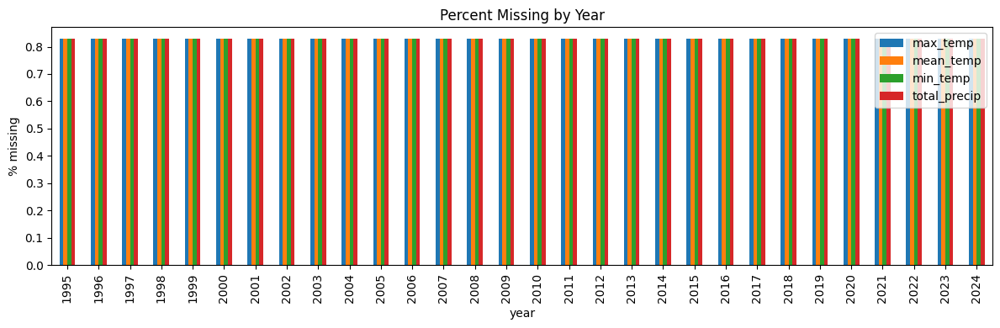

In [21]:
missing = w[weather_cols].isna().mean().sort_values(ascending=False) * 100
print(missing)

# missing over time by year
miss_by_year = w.groupby("year")[weather_cols].apply(lambda x: x.isna().mean()*100)
miss_by_year.plot(kind="bar", figsize=(12,4))
plt.title("Percent Missing by Year")
plt.ylabel("% missing")
plt.tight_layout()
plt.show()


Distributions (max_temp, mean_temp, min_temp, total_precip): Temps span roughly max 0–45°C, mean -10–25°C, min -35–12°C with unimodal/broad shapes; precip is highly right-skewed with many low-month totals and a long tail.

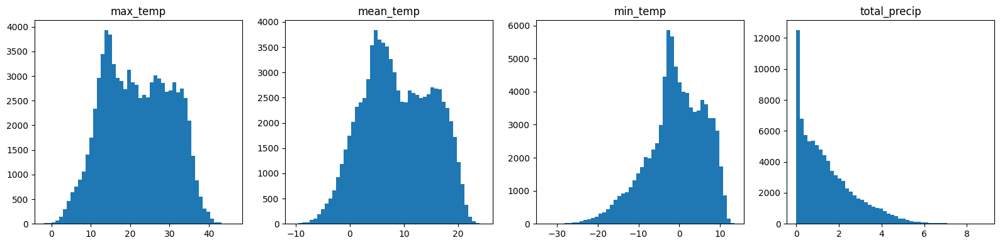

In [22]:
# basic distributions
fig, ax = plt.subplots(1, 4, figsize=(16,4))

for i, col in enumerate(weather_cols):
    ax[i].hist(w[col].dropna(), bins=50)
    ax[i].set_title(col)

plt.tight_layout()
plt.show()


Average Seasonal Cycle: Clear seasonality-temps climb Jan -> Jul/Aug, then fall; precip slightly dips in midsummer and rises in shoulder seasons.

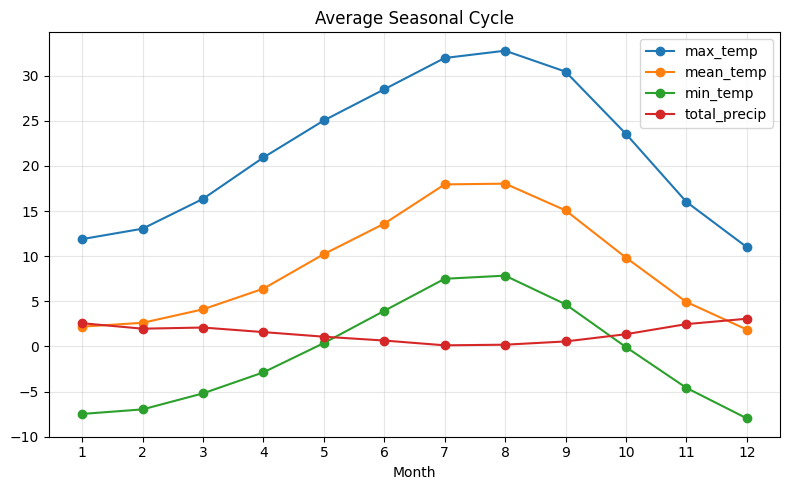

In [23]:
# seasonal cycle (average by month)
monthly_means = w.groupby("month")[weather_cols].mean()

monthly_means.plot(marker="o", figsize=(8,5))
plt.title("Average Seasonal Cycle")
plt.xlabel("Month")
plt.xticks(range(1,13))
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


Yearly Mean Temperatures: Annual means for max/mean/min temps are mostly flat to slightly rising mid-2010s, with interannual wiggles but no sharp trend.

Yearly Mean Total Precip: Precip oscillates year to year (≈1.0–2.1 units), no obvious monotonic trend.

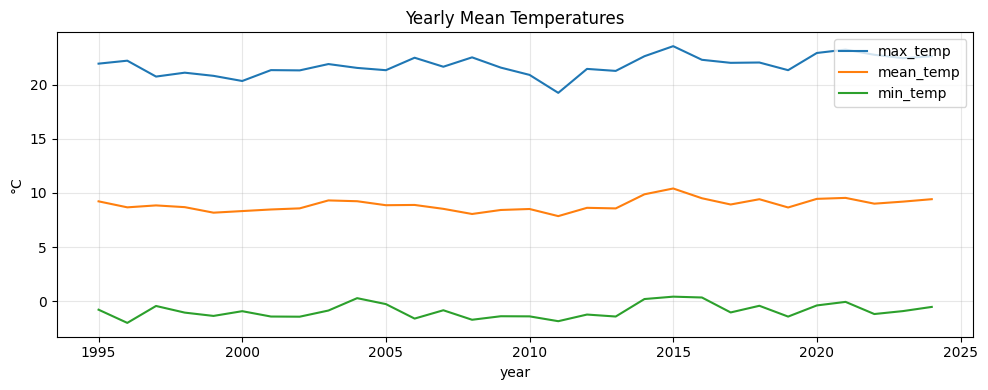

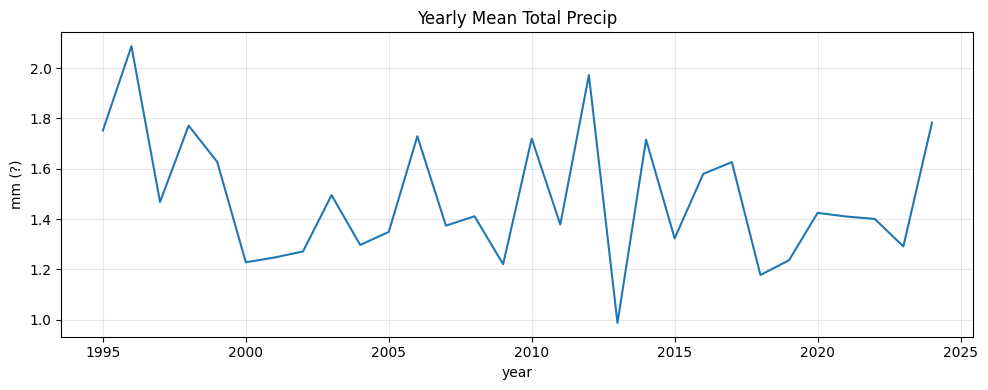

In [24]:
# Time trend over years (climate change / drift check)
yearly = w.groupby("year")[weather_cols].mean()

yearly[["max_temp", "mean_temp", "min_temp"]].plot(figsize=(10,4))
plt.title("Yearly Mean Temperatures")
plt.ylabel("°C")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

yearly["total_precip"].plot(figsize=(10,4))
plt.title("Yearly Mean Total Precip")
plt.ylabel("mm (?)")
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


Min vs Max Temperature: Dense positive correlation; higher mins align with higher maxes, with wider spread at warmer values.

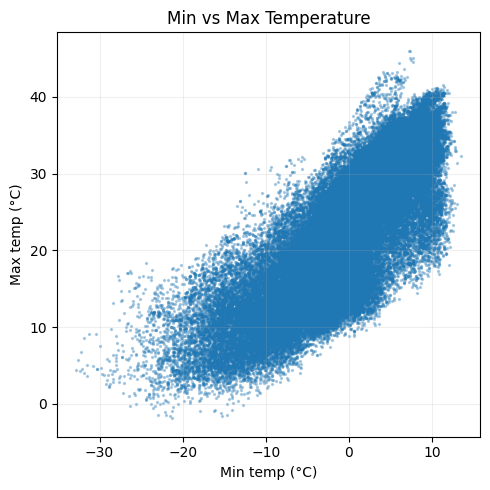

In [25]:
# Max vs Min temp (range)
plt.figure(figsize=(5,5))
plt.scatter(w["min_temp"], w["max_temp"], s=2, alpha=0.3)
plt.xlabel("Min temp (°C)")
plt.ylabel("Max temp (°C)")
plt.title("Min vs Max Temperature")
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()


Mean Temp vs Degree Days (base 10): Degree-day sums stay near zero below ~5–7°C and rise steeply and nonlinearly beyond ~10°C, showing threshold-like growth response.

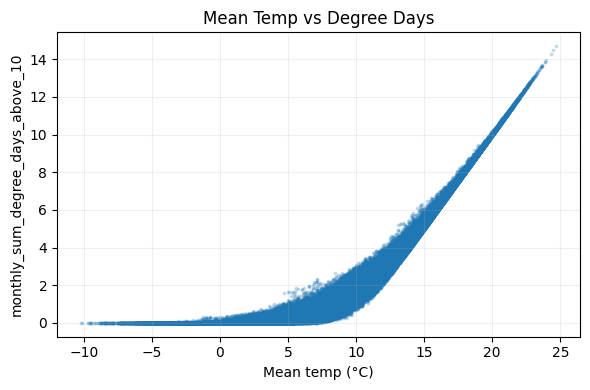

In [26]:
# Mean temp vs Degree Days at a base you care about, lets use base 10
dd_col = "monthly_sum_degree_days_above_10"  # change as needed

plt.figure(figsize=(6,4))
plt.scatter(w["mean_temp"], w[dd_col], s=3, alpha=0.2)
plt.xlabel("Mean temp (°C)")
plt.ylabel(dd_col)
plt.title("Mean Temp vs Degree Days")
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()


Monthly Mean Temp for Sample Sites: All sites share a strong seasonal cycle; interannual variability is modest and curves stay in sync, indicating consistent seasonal patterns across locations.

/var/folders/9n/72lj2wk90kl7ycj6f6kj9xdr0000gn/T/ipykernel_5705/320807389.py:8: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  pivot.resample("M").mean().plot(figsize=(12,5))


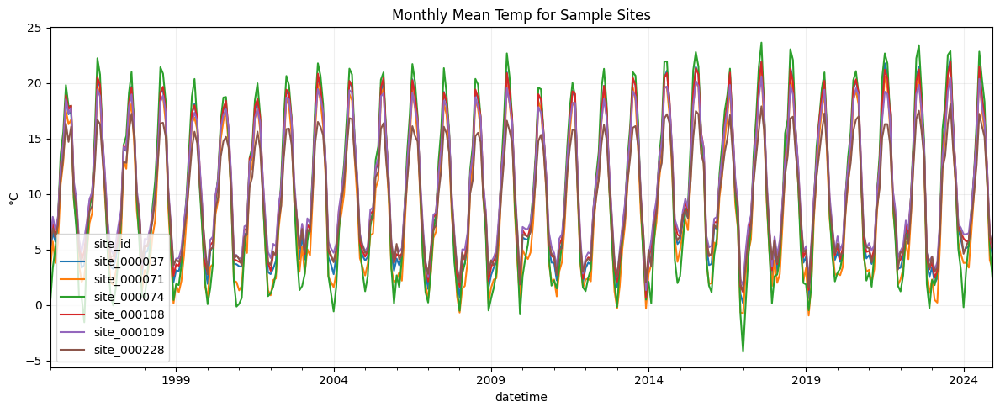

In [27]:
# A quick “site” comparison
np.random.seed(0)
sample_sites = np.random.choice(w["site_id"].unique(), size=6, replace=False)

sub = w[w["site_id"].isin(sample_sites)]

pivot = sub.pivot_table(index="datetime", columns="site_id", values="mean_temp")
pivot.resample("M").mean().plot(figsize=(12,5))
plt.title("Monthly Mean Temp for Sample Sites")
plt.ylabel("°C")
plt.grid(True, alpha=0.2)
plt.tight_layout()
plt.show()


In [28]:
# Extreme events view (heat + wet months)
# hottest months overall
hot = w.sort_values("max_temp", ascending=False).head(20)[
    ["site_id","datetime","max_temp","mean_temp","min_temp"]
]
display(hot)

# wettest months overall
wet = w.sort_values("total_precip", ascending=False).head(20)[
    ["site_id","datetime","total_precip"]
]
display(wet)

,site_id,datetime,max_temp,mean_temp,min_temp
67773,site_000052,2021-06-01,46.013208,19.531421,7.372949
67774,site_000053,2021-06-01,45.958521,19.755468,7.254236
67764,site_000043,2021-06-01,45.022668,20.087890,7.658533
67853,site_000132,2021-06-01,45.018762,19.912660,7.364038
67955,site_000234,2021-06-01,44.817896,19.478353,7.490137
67863,site_000142,2021-06-01,44.594934,19.453393,7.661096
67795,site_000074,2021-06-01,44.459055,20.506776,6.009637
67870,site_000149,2021-06-01,43.589166,18.585574,6.610483
67752,site_000031,2021-06-01,43.254144,18.581347,5.824548
67934,site_000213,2021-06-01,43.198587,18.287717,4.135095


,site_id,datetime,total_precip
25846,site_000059,2015-12-01,8.845512
16908,site_000038,2006-11-01,8.726142
25821,site_000034,2015-12-01,8.698386
16910,site_000040,2006-11-01,8.693166
16906,site_000036,2006-11-01,8.576548
17017,site_000147,2006-11-01,8.576548
25999,site_000212,2015-12-01,8.532817
25914,site_000127,2015-12-01,8.508662
17085,site_000215,2006-11-01,8.479351
16909,site_000039,2006-11-01,8.422998


Plotly does not allow negative marker sizes.

- But winter temperatures (−3°C, −10°C) would cause that error.
- So we convert temperature to a positive number for visual emphasis, not for scientific meaning.

computed: size_temp = mean_temp - min(mean_temp) + 1

If coldest temperature is −15°C, the transform becomes:
- coldest site-month --> size_temp = (−15 - (−15) + 1) = 1
- warmer site --> size_temp = (5 - (−15) + 1) = 21
- hottest site --> maybe size_temp = (~30 - (−15) + 1) = 46


**SO:**
- Larger bubble = warmer temperature
- Smaller bubble = colder temperature

The reason is: We cannot use negative values for size. So we shift all temperatures to be positive. Then warmer values naturally become bigger circles

In [ ]:
import plotly.express as px
import pandas as pd

w["datetime"] = pd.to_datetime(w["datetime"], errors="coerce")
w = w.dropna(subset=["datetime", "LAT", "LON", "mean_temp"])
w = w.sort_values("datetime")

w["month_str"] = w["datetime"].dt.strftime("%Y-%m")

# Aggregate to one row per site per month
w_monthly = (
    w.groupby(["site_id", "month_str"], as_index=False)
    .agg(
        LAT=("LAT", "first"),
        LON=("LON", "first"),
        mean_temp=("mean_temp", "mean"),
        max_temp=("max_temp", "mean"),
        min_temp=("min_temp", "mean"),
        total_precip=("total_precip", "mean"),
    )
)

# --- FIX negative sizes ---
w_monthly["size_temp"] = w_monthly["mean_temp"] - w_monthly["mean_temp"].min() + 1

fig = px.scatter_map(
    w_monthly,
    lat="LAT",
    lon="LON",
    color="mean_temp",      # true temperature
    size="size_temp",       # positive size
    hover_name="site_id",
    hover_data={
        "month_str": True,
        "mean_temp":":.2f",
        "max_temp":":.2f",
        "min_temp":":.2f",
        "total_precip":":.2f"
    },
    animation_frame="month_str",
    animation_group="site_id",
    zoom=3,
    height=650,
    title="Monthly Mean Temperature (Animated)"
)

fig.update_layout(
    mapbox_style="open-street-map",
    margin={"r":0,"t":40,"l":0,"b":0}
)

fig.update_traces(marker=dict(sizemode="area"))
fig.show()